In [1]:
import numpy as np
import pandas as pd


In [2]:
outlier = pd.read_csv('lstm1.csv',delimiter=',', parse_dates=['date'])

In [3]:
outlier['date'] = pd.to_datetime(outlier['date'], unit='d')
outlier.head()

,date,sales
0,2019-01-01,406.0008
1,2019-01-01,826.9992
2,2019-01-01,52.7082
3,2019-01-01,101.5002
4,2019-01-01,203.0004


In [4]:
import seaborn as sns
import matplotlib.pyplot as plt

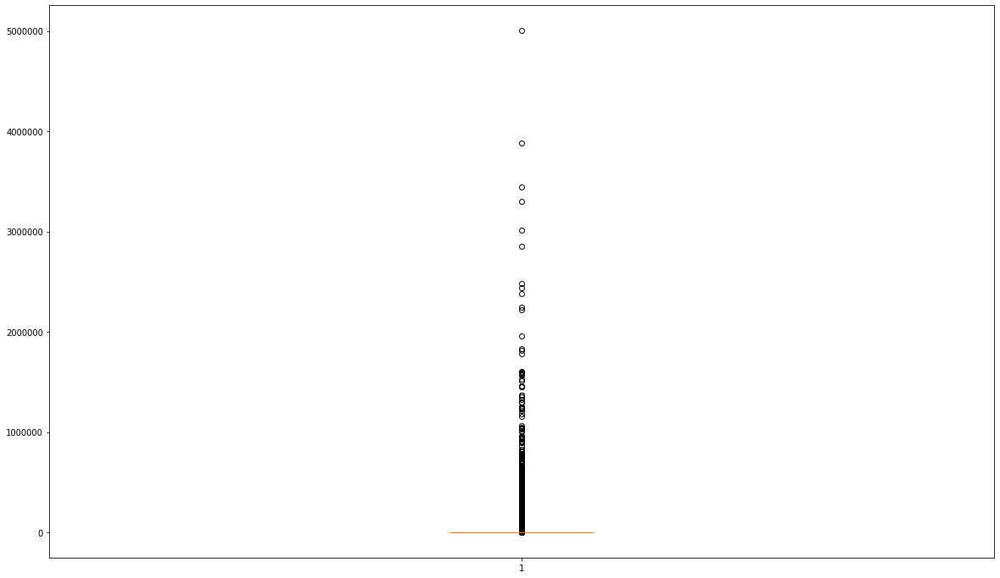

In [5]:
fig , ax1 = plt.subplots(figsize=(20,12))
ax1.boxplot(outlier['sales'])
plt.show()


<function matplotlib.pyplot.show(*args, **kw)>

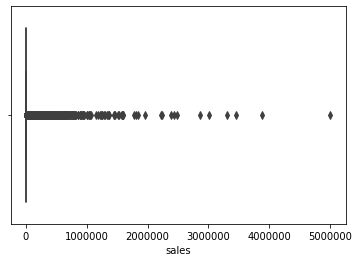

In [6]:
sns.boxplot(x=outlier['sales'])
plt.show

C:\Users\waqarkhan\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\converter.py:103: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)


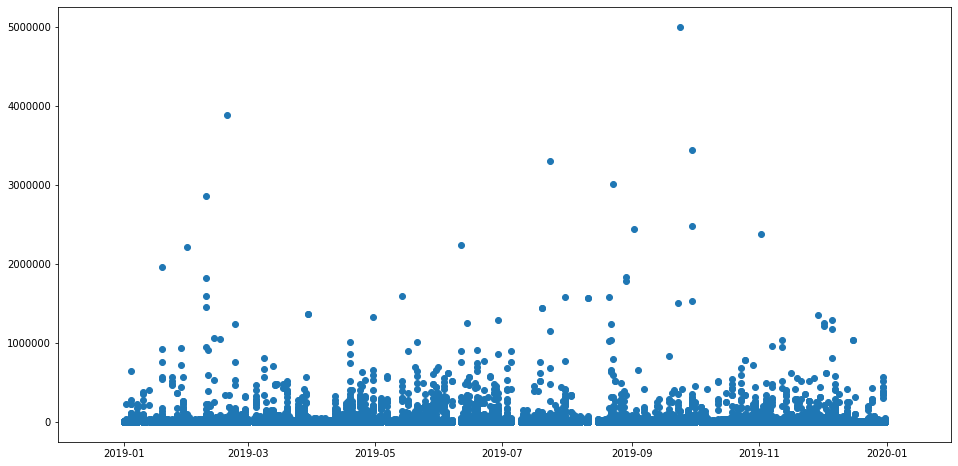

In [7]:
fig , ax = plt.subplots(figsize=(16,8))
ax.scatter(outlier['date'],outlier['sales'])
plt.show()


In [8]:
import scipy
from scipy import stats

In [9]:

z_score = np.abs(stats.zscore(outlier['sales']))
print(z_score)

[0.09288596 0.08425463 0.10012918 ... 0.03420632 1.07156859 0.0282224 ]


In [10]:
threshold = 3
print(np.where(z_score>3))

(array([  1929,   1930,   3432,   3436,   3437,   3439,   4298,   4300,
         6668,   6670,   6671,   6672,   6673,   6674,   8224,   8225,
         8226,   8227,   8955,   8957,   8958,   9289,   9292,   9295,
         9681,   9684,   9685,   9686,   9688,   9697,   9698,   9699,
        10405,  10728,  11944,  11947,  11948,  11949,  13160,  13578,
        14337,  14338,  14339,  14766,  14767,  14768,  15674,  16094,
        16458,  16901,  16902,  16904,  18023,  18027,  18028,  18033,
        18036,  18037,  19341,  19346,  19656,  19657,  21258,  21259,
        21261,  21262,  21268,  21270,  21272,  21273,  21677,  21684,
        21686,  21690,  21694,  21696,  21698,  21699,  22057,  22061,
        22068,  22071,  22777,  23020,  23066,  23201,  23202,  23514,
        23645,  23665,  23668,  24344,  24345,  24346,  24855,  25608,
        25609,  25950,  26367,  26369,  26419,  26420,  26421,  26422,
        26423,  26424,  26426,  26461,  26464,  27910,  27918,  27919,
     

In [11]:
Q1 = outlier['sales'].quantile(0.25)
Q3 = outlier['sales'].quantile(0.75)
IQR = Q3-Q1
print(IQR)

828.1247999999999


In [12]:
outliero = outlier
#print(out)
#print(out < (~Q1 - 1.5 * IQR)) |(out > (Q3 + 1.5 * IQR))

In [13]:
#outliero[(np.abs(stats.zscore(df)) < 3).all(axis=1)]
outliero= outliero[(z_score < 3)]

In [14]:
outliero.shape

(113930, 2)

TypeError: unsupported operand type(s) for +: 'Timestamp' and 'float'

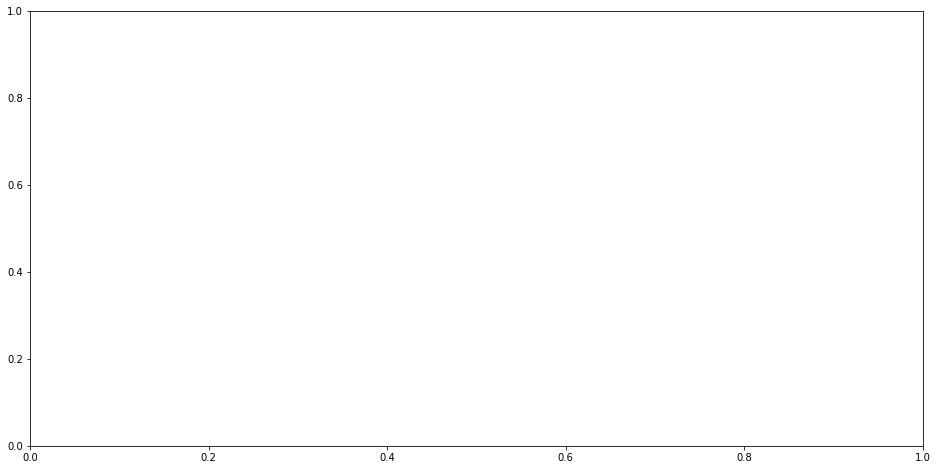

In [15]:
fig , ax2 = plt.subplots(figsize=(16,8))
ax2.boxplot(outliero)
plt.show()

In [16]:
outliero.head()

,date,sales
0,2019-01-01,406.0008
1,2019-01-01,826.9992
2,2019-01-01,52.7082
3,2019-01-01,101.5002
4,2019-01-01,203.0004


In [17]:
outliero.describe()

,sales
count,113930.000000
mean,2407.560151
std,8462.832578
min,0.000000
25%,445.000000
50%,735.666400
75%,1264.000000
max,150982.297800


In [18]:
#df = pd.read_excel('IVY DATA Normalized.xlsx')

In [19]:
#df.head()

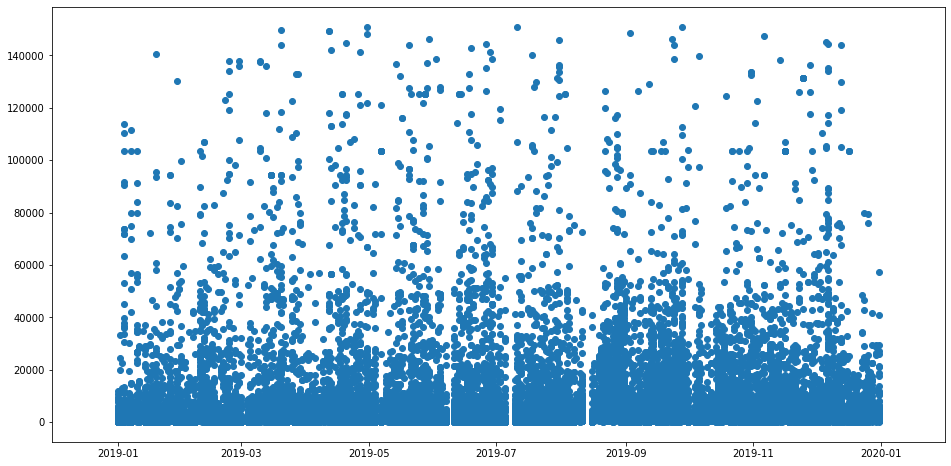

In [20]:
fig , ax3 = plt.subplots(figsize=(16,8))
ax3.scatter(outliero['date'],outliero['sales'])
plt.show()

In [23]:
%matplotlib inline
import matplotlib.pyplot as plt
import chart_studio.plotly as py
import plotly.offline as pyoff
import plotly.graph_objs as go

In [24]:
plot_data = [
    go.Scatter(
        x=outliero['date'],
        y=outliero['sales'],
    )
]
plot_layout = go.Layout(
        title='Daily sales'
    )
fig = go.Figure(data=plot_data, layout=plot_layout)
pyoff.iplot(fig)

In [25]:
from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.graphics.tsaplots import plot_pacf

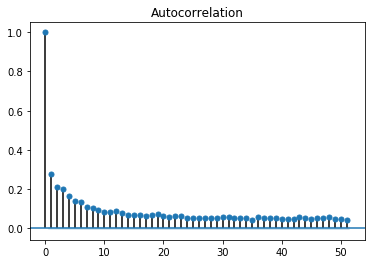

In [26]:
plot_acf(pd.Series(outliero['sales']))
plt.show()

In [27]:
from __future__ import division
from datetime import datetime, timedelta,date
import keras
from keras.layers import Dense
from keras.models import Sequential
from keras.optimizers import Adam 
from keras.callbacks import EarlyStopping
from keras.utils import np_utils
from keras.layers import LSTM
from sklearn.model_selection import KFold, cross_val_score, train_test_split
pyoff.init_notebook_mode()

Using TensorFlow backend.


In [28]:
outliero['date'] = pd.to_datetime(outliero['date'], unit='d')
# week_df = df_sales.resample('W').mean()
# print(week_df)
outliero.head()

C:\Users\waqarkhan\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,date,sales
0,2019-01-01,406.0008
1,2019-01-01,826.9992
2,2019-01-01,52.7082
3,2019-01-01,101.5002
4,2019-01-01,203.0004


In [29]:
df_diff = outliero.copy()
#add previous sales to the next row
df_diff['prev_sales'] = df_diff['sales'].shift(1)
#drop the null values and calculate the difference
df_diff = df_diff.dropna()
df_diff['diff'] = (df_diff['sales'] - df_diff['prev_sales'])

In [30]:
df_diff.head()

,date,sales,prev_sales,diff
1,2019-01-01,826.9992,406.0008,420.9984
2,2019-01-01,52.7082,826.9992,-774.2910
3,2019-01-01,101.5002,52.7082,48.7920
4,2019-01-01,203.0004,101.5002,101.5002
5,2019-01-01,105.4164,203.0004,-97.5840


In [32]:
df_supervised = df_diff.drop(['prev_sales'],axis=1)
#adding lags
for inc in range(1):
    field_name = 'lag_' + str(inc)
    df_supervised[field_name] = df_supervised['diff'].shift(inc)
#drop null values
df_supervised = df_supervised.dropna().reset_index(drop=False)

In [33]:
df_supervised.head()

,index,date,sales,diff,lag_0
0,1,2019-01-01,826.9992,420.9984,420.9984
1,2,2019-01-01,52.7082,-774.2910,-774.2910
2,3,2019-01-01,101.5002,48.7920,48.7920
3,4,2019-01-01,203.0004,101.5002,101.5002
4,5,2019-01-01,105.4164,-97.5840,-97.5840


In [34]:
#plot sales diff
plot_data = [
    go.Scatter(
        x=df_diff['date'],
        y=df_diff['diff'],
    )
]
plot_layout = go.Layout(
        title='Montly Sales Diff'
    )
fig = go.Figure(data=plot_data, layout=plot_layout)
pyoff.iplot(fig)

In [ ]:
df_supervised = df_diff.drop(['prev_sales'],axis=1)
#adding lags
for inc in range(1):
    field_name = 'lag_' + str(inc)
    df_supervised[field_name] = df_supervised['diff'].shift(inc)
#drop null values
#df_supervised = df_supervised.dropna().reset_index(drop=False)

In [ ]:
df_supervised.head()

In [ ]:
import statsmodels.formula.api as smf
# Define the regression formula
model = smf.ols(formula='diff ~ lag_0', data=df_supervised)
# Fit the regression
model_fit = model.fit()
# Extract the adjusted r-squared
regression_adj_rsq = model_fit.rsquared_adj
print(regression_adj_rsq)

In [ ]:
from sklearn.preprocessing import MinMaxScaler

In [ ]:
df_model = df_supervised.drop(['sales','date'],axis=1)
#split train and test set
train_set, test_set = df_model[0:90000].values, df_model[90000:].values
df_model.info()

In [ ]:
#apply Min Max Scaler
scaler = MinMaxScaler(feature_range=(-1, 1))
scaler = scaler.fit(train_set)
# reshape training set
train_set = train_set.reshape(train_set.shape[0], train_set.shape[1])
train_set_scaled = scaler.transform(train_set)
# reshape test set
test_set = test_set.reshape(test_set.shape[0], test_set.shape[1])
test_set_scaled = scaler.transform(test_set)

In [ ]:
X_train, y_train = train_set_scaled[:, 1:], train_set_scaled[:, 0:1]
X_train = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
X_test, y_test = test_set_scaled[:, 1:], test_set_scaled[:, 0:1]
X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

In [ ]:
model = Sequential()
model.add(LSTM(4, batch_input_shape=(1, X_train.shape[1], X_train.shape[2]), stateful=True))
model.add(Dense(1))
model.compile(loss='mean_squared_error', optimizer='adam')
model.fit(X_train, y_train, nb_epoch=1, batch_size=1, verbose=1, shuffle=False)

In [ ]:
y_pred = model.predict(X_test,batch_size=1)

In [ ]:
y_pred

In [ ]:
y_test

In [ ]:
y_pred = y_pred.reshape(y_pred.shape[0], 1, y_pred.shape[1])

In [ ]:
pred_test_set = []
for index in range(0,len(y_pred)):
    print (np.concatenate([y_pred[index],X_test[index]],axis=1,))
    pred_test_set.append(np.concatenate([y_pred[index],X_test[index]],axis=1))

In [ ]:
pred_test_set[0]

In [ ]:
pred_test_set = np.array(pred_test_set)
pred_test_set = pred_test_set.reshape(pred_test_set.shape[0], pred_test_set.shape[2])

In [ ]:
pred_test_set_inverted = scaler.inverse_transform(pred_test_set)

In [ ]:
result_list = []
sales_dates = list(outliero[89999:].date)
act_sales = list(outliero[89999:].sales)
for index in range(0,len(pred_test_set_inverted)):
    result_dict = {}
    result_dict['pred_value'] = int(pred_test_set_inverted[index][0] + act_sales[index])
    result_dict['date'] = sales_dates[index+1]
    result_list.append(result_dict)
df_result = pd.DataFrame(result_list)

In [ ]:
df_result

In [ ]:
df_sales_pred = pd.merge(outliero,df_result,on='date',how='left')

In [ ]:
df_sales_pred

In [ ]:
df_sales_pred.tail(20)

In [ ]:
plot_data = [
    go.Scatter(
        x=df_sales_pred['date'],
        y=df_sales_pred['sales'],
        name='actual'
    ),
        go.Scatter(
        x=df_sales_pred['date'],
        y=df_sales_pred['pred_value'],
        name='predicted'
    )
    
]

plot_layout = go.Layout(
        title='Sales Prediction'
    )
fig = go.Figure(data=plot_data, layout=plot_layout)
pyoff.iplot(fig)